In [184]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests

from sklearn.preprocessing import OrdinalEncoder, MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, GridSearchCV, cross_val_score, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, auc, roc_curve,accuracy_score, f1_score, roc_auc_score, log_loss,cohen_kappa_score, classification_report, recall_score, precision_score, make_scorer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN, BorderlineSMOTE, KMeansSMOTE
from imblearn.under_sampling import ClusterCentroids, RandomUnderSampler

In [185]:
# Data Import

In [186]:
url = 'https://archive.ics.uci.edu/static/public/222/data.csv'

request = requests.get(url)
with open("../data/raw/bank-full.csv", 'wb') as f:
        f.write(request.content)

# Global Config

In [187]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format
random_state = 522

### Pre-Exploration

In [188]:
bank = pd.read_csv('../data/raw/bank-full.csv', sep=',')

In [189]:
# bank_additional

In [190]:
bank.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day_of_week', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'y'],
      dtype='object')

In [191]:
bank.shape

(45211, 17)

In [192]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [193]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [194]:
bank.y.value_counts()/len(bank)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Pay attention that the target is **class-imbalanced**

# global config

In [195]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format
RANDOM_STATE = 522

# Train Test Split

In [196]:
bank_train, bank_test = train_test_split(bank
                                        , test_size=0.2
                                        , random_state=RANDOM_STATE
                                        , stratify=bank.y
                                        )

In [197]:
bank_train.y.value_counts()/len(bank_train)

y
no    0.883
yes   0.117
Name: count, dtype: float64

In [198]:
X_train, y_train = bank_train.drop(columns=["y"]), bank_train["y"]
X_test, y_test = bank_test.drop(columns=["y"]), bank_test["y"]

Via stratified split, we managed to keep the distribution of the label in the original dataset.

# EDA

In [199]:
for i in list(bank_train.columns):
    print(f"{i:<10}->  {bank_train[i].nunique():<5} unique values")

age       ->  77    unique values
job       ->  11    unique values
marital   ->  3     unique values
education ->  3     unique values
default   ->  2     unique values
balance   ->  6601  unique values
housing   ->  2     unique values
loan      ->  2     unique values
contact   ->  2     unique values
day_of_week->  31    unique values
month     ->  12    unique values
duration  ->  1506  unique values
campaign  ->  47    unique values
pdays     ->  536   unique values
previous  ->  40    unique values
poutcome  ->  3     unique values
y         ->  2     unique values


In [200]:
bank_int = list(bank_train.select_dtypes(include = ['int64']).columns)
bank_str = list(bank_train.select_dtypes(include = ['object']).columns)
# bank_str.remove("y")
bank_categorical = bank_str+['day']

In [201]:
bank_categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y',
 'day']

## Data Viz

In [202]:
bank.education.value_counts()

education
secondary    23202
tertiary     13301
primary       6851
Name: count, dtype: int64

In [203]:
bank.education.isna().sum()

1857

In [204]:
import altair as alt

alt.data_transformers.disable_max_rows()

charts = []

for i, var in enumerate(bank_categorical):
    if i == 9:  
        break

    num_rows = len(bank_train[var].unique())

    chart = alt.Chart(bank_train).mark_bar(stroke=None).encode(
        x=alt.X('count()', title='Count'),
        y=alt.Y('y:N', title=None),
        color=alt.Color('y:N', scale=alt.Scale(range=['#3C6682', '#45A778'])),
        row=alt.Row(f'{var}:N')
    ).properties(
        width=200,
        height=200 / num_rows,
        title=f'Grouped Bar Plot for {var}',
        spacing=0
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False).configure_header(
    labelAngle=0,
    labelAlign='left'
)

final_chart


alt.ConcatChart(...)

# Altair

In [205]:
bank_continuous = bank_train[bank_int]

charts = []

for i, column in enumerate(bank_continuous.columns):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

# Altair

In [206]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
charts = []

for i, column in enumerate(bank_log):
    hist_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

/tmp/ipykernel_44833/2615118493.py:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  hist_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).mark_bar(opacity=0.7, color='steelblue').encode(
/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/pandas/core/algorithms.py:1814: RuntimeWarning: invalid value encountered in log1p
  return lib.map_infer(values, mapper, convert=convert)
/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/pandas/core/algorithms.py:1814: RuntimeWarning: divide by zero encountered in log1p
  return lib.map_infer(values, mapper, convert=convert)
/tmp/ipykernel_44833/2615118493.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  kde_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).transform_density(
/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/pandas/core/algorithms.py:1814: RuntimeWarning: invalid value encountered in log1p
  return lib

alt.ConcatChart(...)

# Preprocessing

In this section, we are defining lists with the names of the features according to their type. 

In [207]:
numeric_features = bank.select_dtypes('number').columns.tolist()
categorical_features = ['job', 'marital', 'contact', 'month', 'poutcome']
ordinal_features = ['education']
binary_features = ['default', 'housing', 'loan']
drop_features = []
target = "y"

Then, we define all the transformations that have to be applied to the different columns. We define the order of the education levels as they belong to an ordinal variable and we create pipelines to manage nulls before each transformation. All of the transformations impute the most frequent value except for the numeric transformer, which imputes the median value.

In [208]:
education_levels = ['tertiary', 'secondary', 'primary']
ordinal_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OrdinalEncoder(categories=[education_levels], dtype=int))

numeric_transformer = make_pipeline(SimpleImputer(strategy="median"), StandardScaler())

binary_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OneHotEncoder(dtype=int, drop='if_binary'))

categorical_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                        OneHotEncoder(handle_unknown="ignore", sparse_output=False))

Finally, we create a column transformer named preprocessor.

In [209]:
preprocessor = ColumnTransformer(
    transformers=[
        ('numeric', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_features),
        ('binary', binary_transformer, binary_features),
        ('categorical', categorical_transformer, categorical_features),
        ('drop', 'passthrough', drop_features)
    ])

### Fitting and transforming X_train

In [210]:
transformed_train = preprocessor.fit_transform(X_train)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_train_trans = pd.DataFrame(transformed_train, columns=column_names)

In [211]:
X_train_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,-0.463,-0.413,0.627,-0.733,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,1.612,-0.072,-1.418,-0.679,0.072,-0.411,-0.243,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,-0.086,-0.408,-1.418,-0.510,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,-0.369,-0.445,-1.178,-0.421,-0.564,-0.271,4.767,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000
4,0.197,-0.292,1.228,-0.283,-0.564,-0.411,-0.243,1.000,0.000,1.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000


In [212]:
y_train.head(5)

4868     no
29723    no
8911     no
34737    no
5657     no
Name: y, dtype: object

### Transforming X_test

In [213]:
transformed_test = preprocessor.transform(X_test)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_test_trans = pd.DataFrame(transformed_test, columns=column_names)

In [214]:
X_test_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,1.235,-0.278,-1.178,-0.241,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,0.480,-0.189,0.747,-0.471,0.390,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,0.291,0.351,1.709,-0.483,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,1.517,-0.445,-0.215,-0.514,0.708,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
4,1.706,-0.110,-1.298,1.578,-0.564,-0.411,-0.243,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000


In [215]:
y_test.head(5)

685       no
16193     no
17989     no
38058     no
24132    yes
Name: y, dtype: object

# Modeling

In [217]:
def compute_and_plot_roc_curve(model, testing_x, testing_y,name, figsize=(5,5)):
    predict_prob = model.predict_proba(testing_x)
    fpr, tpr, threshold = metrics.roc_curve(testing_y, predict_prob[:,1])
    roc_auc = metrics.auc(fpr, tpr)
    plt.figure(figsize=(5,5),facecolor="white")
    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = '{} : {:0.3f}'.format(name,roc_auc))
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
    
    return fpr, tpr, roc_auc

In [218]:
def model_report(model, testing_x, testing_y, name, customerized_threshold=False, threshold=0.5, plot_confusion_matrix = True) :

    predictions  = model.predict(testing_x)
    predictions_prob = model.predict_proba(testing_x)
    
    if customerized_threshold:
        predictions = []
        for pred in predictions_prob[:,1]:  
            predictions.append(1) if pred > threshold else predictions.append(0) 
    recallscore  = recall_score(testing_y,predictions)
    precision    = precision_score(testing_y,predictions)
    roc_auc      = roc_auc_score(testing_y,predictions_prob[:, 1])
    f1score      = f1_score(testing_y,predictions) 
    # kappa_metric = cohen_kappa_score(testing_y,predictions)
    # MCC          = matthews_corrcoef(testing_y, predictions)
    
    
    # classification_report
    print(classification_report(testing_y,predictions))
    
    # customered_confusion_matrix
    if plot_confusion_matrix:   
        fact = testing_y
        classes = list(set(fact))
        classes.sort()
        confusion = confusion_matrix(predictions, testing_y)
        plt.figure(figsize=(5,5), dpi=100)
        plt.imshow(confusion, cmap=plt.cm.Blues)
    #     plt.imshow(confusion, cmap="viridis")
        indices = range(len(confusion))
        plt.xticks(indices, classes,fontsize=10)
        plt.yticks(indices, classes,fontsize=10)
        plt.colorbar()
        plt.xlabel('Predictions',fontsize=10)
        plt.ylabel('Ground Turth',fontsize=10)
        for first_index in range(len(confusion)):
            for second_index in range(len(confusion[first_index])):
                plt.text(first_index, second_index, confusion[first_index][second_index],va = 'center',ha = 'center',c='darkorange',fontsize=10)
        plt.grid(False)
    
    df = pd.DataFrame({"Model"           : [name],
                       "Recall_score"    : [recallscore],
                       "Precision"       : [precision],
                       "f1_score"        : [f1score],
                       "Area_under_curve": [roc_auc]
                       # "Kappa_metric"    : [kappa_metric],
                       # "MCC"             : [MCC]
                      })
    return df

In [219]:
def highlight_first_3_rows(row):
    if row.name < 4:
        return ['background-color: yellow'] * len(row)
    return [''] * len(row)

# resample

Because it is a class-imbalanced issue, we decided to utilize some resample technique to boost the performance of our model. reference: https://imbalanced-learn.org/stable/under_sampling.html

In [220]:
resample_list = ['random_over_sample','SMOTE','ADASYN','BorderlineSMOTE','KMeansSMOTE', 'ClusterCentroids','random_under_sample']

def re_sample(X, y, func=None, random_state=RANDOM_STATE):
    if func == None:
        return
    
    elif func == 'random_over_sample':
        ros = RandomOverSampler(random_state=random_state)
        X_resampled, y_resampled = ros.fit_resample(X, y)
    
    elif func == 'SMOTE':
        X_resampled, y_resampled = SMOTE().fit_resample(X, y)
    
    elif func == 'ADASYN':
        X_resampled, y_resampled = ADASYN().fit_resample(X, y)
        
    elif func == 'BorderlineSMOTE':
        X_resampled, y_resampled = BorderlineSMOTE().fit_resample(X, y)
        
    elif func == 'KMeansSMOTE':
        X_resampled, y_resampled = KMeansSMOTE(cluster_balance_threshold=0.005).fit_resample(X, y) # https://arxiv.org/pdf/1711.00837.pdf
    
    elif func == 'ClusterCentroids':
        X_resampled, y_resampled = ClusterCentroids().fit_resample(X, y)
        
    elif func == 'random_under_sample':
        X_resampled, y_resampled = RandomUnderSampler().fit_resample(X, y) 
    
    else:
        return

    return X_resampled, y_resampled

In [221]:
X_tr, y_tr= re_sample(X_train, y_train, func='random_under_sample')
y_tr = y_tr.map({'yes':1, 'no':0})
y_test = y_test.map({'yes':1, 'no':0})

In [222]:
y_test

685      0
16193    0
17989    0
38058    0
24132    1
        ..
41512    1
40278    1
36878    0
11589    0
23945    0
Name: y, Length: 9043, dtype: int64

In [223]:
y_tr.value_counts()

y
0    4231
1    4231
Name: count, dtype: int64

In [224]:
X_tr

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
5632,53,admin.,married,secondary,no,7598,yes,no,NaN,23,may,27,7,-1,0,NaN
39192,35,management,single,tertiary,no,-292,yes,no,cellular,18,may,166,2,272,6,failure
44959,36,technician,single,secondary,no,966,no,no,cellular,8,oct,135,2,91,13,failure
15411,39,blue-collar,divorced,secondary,no,241,yes,no,cellular,18,jul,117,2,-1,0,NaN
34116,30,blue-collar,married,secondary,no,4389,yes,no,cellular,30,apr,82,6,-1,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35956,59,retired,married,tertiary,no,148,yes,yes,cellular,8,may,685,2,366,1,other
39773,45,blue-collar,married,secondary,no,1723,no,no,cellular,1,jun,166,2,-1,0,NaN
44778,58,management,married,tertiary,no,0,no,no,cellular,14,sep,358,2,-1,0,NaN
17794,46,admin.,married,secondary,no,659,yes,no,telephone,29,jul,1127,11,-1,0,NaN


In [225]:
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=RANDOM_STATE),
    "KNN": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB(),
    "Logistic Regression": LogisticRegression(max_iter=2000, random_state=RANDOM_STATE)
}

# logistic regression

In [226]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3)
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Logistic Regression']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [227]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                               'passthrough',
                                                                               [])])),
                                             ('logisticregression',
                                              LogisticRegression(max_iter=2000,
                                                                 random_state=522))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'logisticregression__C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fd362bb4af0>},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [228]:
random_search.best_params_

{'logisticregression__C': 116.7540890727246}

In [229]:
random_search.best_score_

0.9032408744399636

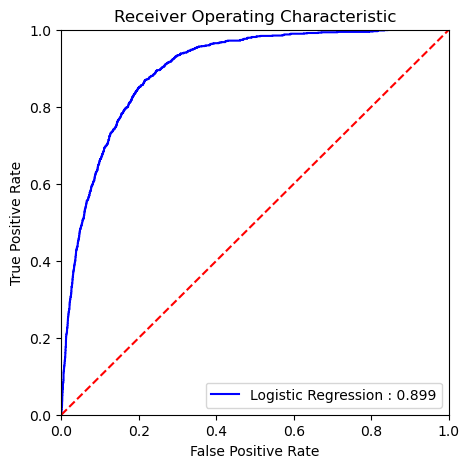

              precision    recall  f1-score   support

           0       0.97      0.84      0.90      7985
           1       0.39      0.79      0.53      1058

    accuracy                           0.83      9043
   macro avg       0.68      0.81      0.71      9043
weighted avg       0.90      0.83      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Logistic Regression,0.789,0.394,0.525,0.899


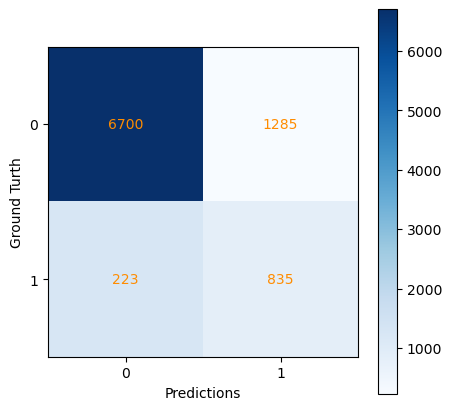

In [230]:
# Logistic Regression on the test set

# Use the selected hyperparameters
best_C = random_search.best_params_['logisticregression__C']

pipe_lr = make_pipeline(
    preprocessor,
    LogisticRegression(C=best_C,
                        random_state=RANDOM_STATE) 
    )
# Train the model
pipe_lr.fit(X_tr,  y_tr)

fpr_lr, tpr_lr, auc_lr= compute_and_plot_roc_curve(pipe_lr, X_test,  y_test, "Logistic Regression")

model_lr = model_report(pipe_lr, X_test, y_test, "Logistic Regression")
model_lr

# knn

In [231]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "kneighborsclassifier__n_neighbors": range(10,50),
    "kneighborsclassifier__weights":['uniform', 'distance']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['KNN']  
    )

grid_search = GridSearchCV(pipe, 
                             param_dist, 
                             n_jobs=-1, 
                             cv=5,
                             scoring=classification_metrics,
                             refit='roc_auc',
                             return_train_score=True
                            )

In [232]:
grid_search.fit(X_tr, y_tr)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('columntransformer',
                                        ColumnTransformer(transformers=[('numeric',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('standardscaler',
                                                                                          StandardScaler())]),
                                                                         ['age',
                                                                          'balance',
                                                                          'day_of_week',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinal',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer(strat...
                                                                         ['job',
                                                                          'marital',
                                                                          'contact',
                                                                          'month',
                                                                          'poutcome']),
                                                                        ('drop',
                                                                         'passthrough',
                                                                         [])])),
                                       ('kneighborsclassifier',
                                        KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'kneighborsclassifier__n_neighbors': range(10, 50),
                         'kneighborsclassifier__weights': ['uniform',
                                                           'distance']},
             refit='roc_auc', return_train_score=True,
             scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [233]:
grid_search.best_params_

{'kneighborsclassifier__n_neighbors': 20,
 'kneighborsclassifier__weights': 'distance'}

In [234]:
grid_search.best_score_

0.896274762061077

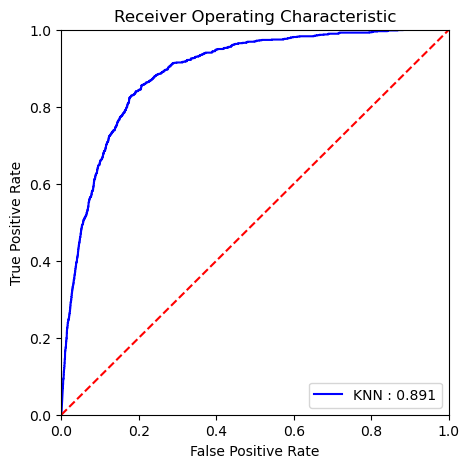

              precision    recall  f1-score   support

           0       0.96      0.86      0.91      7985
           1       0.41      0.76      0.53      1058

    accuracy                           0.84      9043
   macro avg       0.69      0.81      0.72      9043
weighted avg       0.90      0.84      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,KNN,0.761,0.410,0.533,0.891


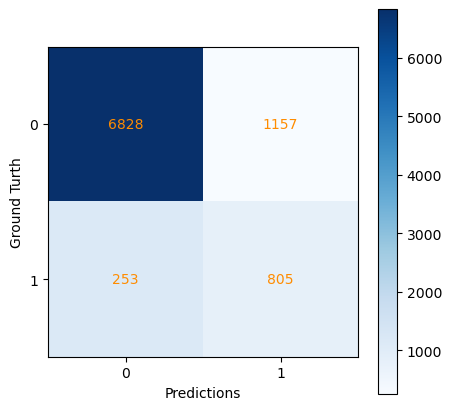

In [235]:
# Use the selected hyperparameters
best_n_neighbors = grid_search.best_params_['kneighborsclassifier__n_neighbors']
best_weights = grid_search.best_params_['kneighborsclassifier__weights']

pipe = make_pipeline(
    preprocessor,
    KNeighborsClassifier(n_neighbors=best_n_neighbors,
                         weights=best_weights
                        ) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_knn, tpr_knn, auc_knn= compute_and_plot_roc_curve(pipe, X_test,  y_test, "KNN")

model_knn = model_report(pipe, X_test, y_test, "KNN")
model_knn

# Decision Tree 

In [236]:
param_dist = {
    "decisiontreeclassifier__max_depth": range(2, 200),
    "decisiontreeclassifier__criterion": ['gini', 'entropy', 'log_loss']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Decision Tree']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [237]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                               'passthrough',
                                                                               [])])),
                                             ('decisiontreeclassifier',
                                              DecisionTreeClassifier(random_state=522))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'decisiontreeclassifier__criterion': ['gini',
                                                                              'entropy',
                                                                              'log_loss'],
                                        'decisiontreeclassifier__max_depth': range(2, 200)},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [238]:
random_search.best_params_

{'decisiontreeclassifier__max_depth': 6,
 'decisiontreeclassifier__criterion': 'entropy'}

In [239]:
random_search.best_score_

0.8704333632417093

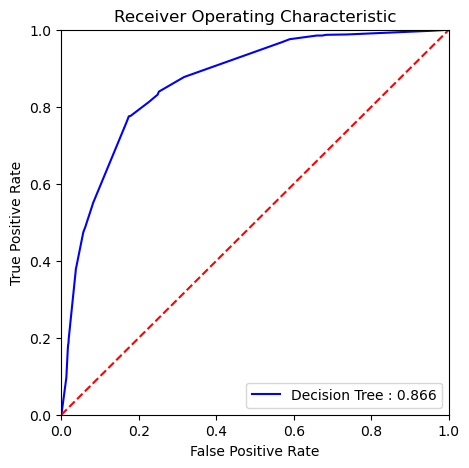

              precision    recall  f1-score   support

           0       0.97      0.83      0.89      7985
           1       0.37      0.78      0.50      1058

    accuracy                           0.82      9043
   macro avg       0.67      0.80      0.70      9043
weighted avg       0.90      0.82      0.84      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Decision Tree,0.775,0.371,0.502,0.866


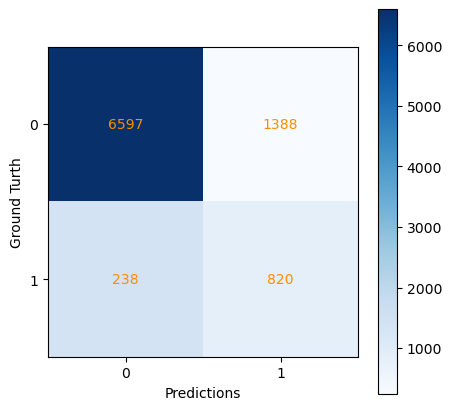

In [240]:
# Use the selected hyperparameters
best_max_depth = random_search.best_params_['decisiontreeclassifier__max_depth']
best_criterion= random_search.best_params_['decisiontreeclassifier__criterion']

pipe = make_pipeline(
    preprocessor,
    DecisionTreeClassifier(max_depth=best_max_depth,
                           criterion=best_criterion
                           ) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_dt, tpr_dt, auc_dt = compute_and_plot_roc_curve(pipe, X_test,  y_test, "Decision Tree")

model_dt = model_report(pipe, X_test, y_test, "Decision Tree")
model_dt

# Naive Bayes

In [241]:
param_dist = {
    "gaussiannb__var_smoothing": uniform(0, 1),
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Naive Bayes']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [242]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                                'contact',
                                                                                'month',
                                                                                'poutcome']),
                                                                              ('drop',
                                                                               'passthrough',
                                                                               [])])),
                                             ('gaussiannb', GaussianNB())]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'gaussiannb__var_smoothing': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fd3720d8430>},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [243]:
random_search.best_params_

{'gaussiannb__var_smoothing': 0.12689168652321414}

In [244]:
random_search.best_score_

0.8468402249847303

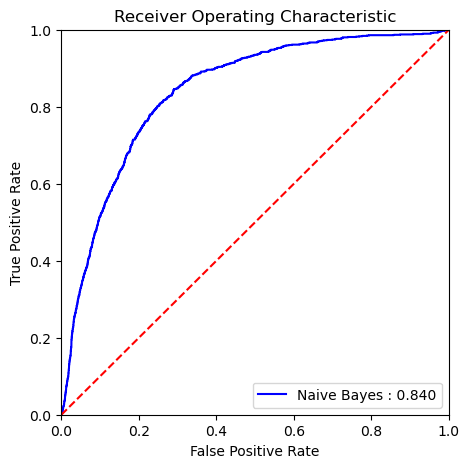

              precision    recall  f1-score   support

           0       0.94      0.89      0.91      7985
           1       0.39      0.55      0.46      1058

    accuracy                           0.85      9043
   macro avg       0.66      0.72      0.68      9043
weighted avg       0.87      0.85      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Naive Bayes,0.553,0.391,0.458,0.840


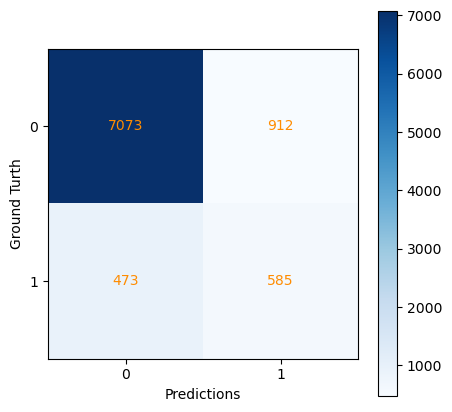

In [245]:
# Use the selected hyperparameters
best_var_smoothing = random_search.best_params_['gaussiannb__var_smoothing']

pipe = make_pipeline(
    preprocessor,
    GaussianNB(var_smoothing=best_var_smoothing) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_nb, tpr_nb, auc_nb= compute_and_plot_roc_curve(pipe, X_test,  y_test, "Naive Bayes")

model_nb = model_report(pipe, X_test, y_test, "Naive Bayes")
model_nb

# Performance of all models

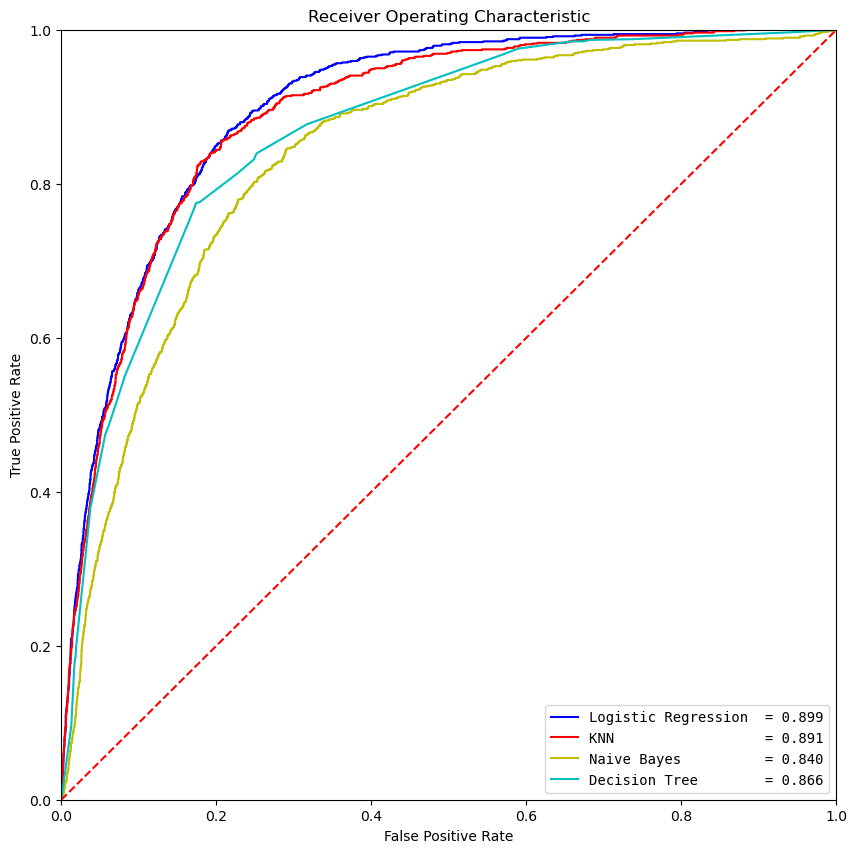

In [246]:
plt.figure(figsize=(10,10))
plt.title('Receiver Operating Characteristic')


plt.plot(fpr_lr, tpr_lr, 'b', label = '{:<20} = {:0.3f}'.format("Logistic Regression",auc_lr))
plt.plot(fpr_knn, tpr_knn, 'r', label = '{:<20} = {:0.3f}'.format("KNN",auc_knn))
plt.plot(fpr_nb, tpr_nb, 'y', label = '{:<20} = {:0.3f}'.format("Naive Bayes",auc_nb))
plt.plot(fpr_dt, tpr_dt, 'c', label = '{:<20} = {:0.3f}'.format("Decision Tree",auc_dt))

plt.legend(loc = 'lower right',prop={'family': 'monospace'})
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [247]:
pd.concat([model_lr,model_knn, model_dt, model_nb]).sort_values(by=['Area_under_curve'], ascending=False).reset_index(drop=True)

,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Logistic Regression,0.789,0.394,0.525,0.899
1,KNN,0.761,0.410,0.533,0.891
2,Decision Tree,0.775,0.371,0.502,0.866
3,Naive Bayes,0.553,0.391,0.458,0.840


# feature importance

In [248]:
logistic_regression_model = pipe_lr.named_steps['logisticregression']
coefficients = list(logistic_regression_model.coef_[0])
feature_names = X_train_trans.columns.to_list()

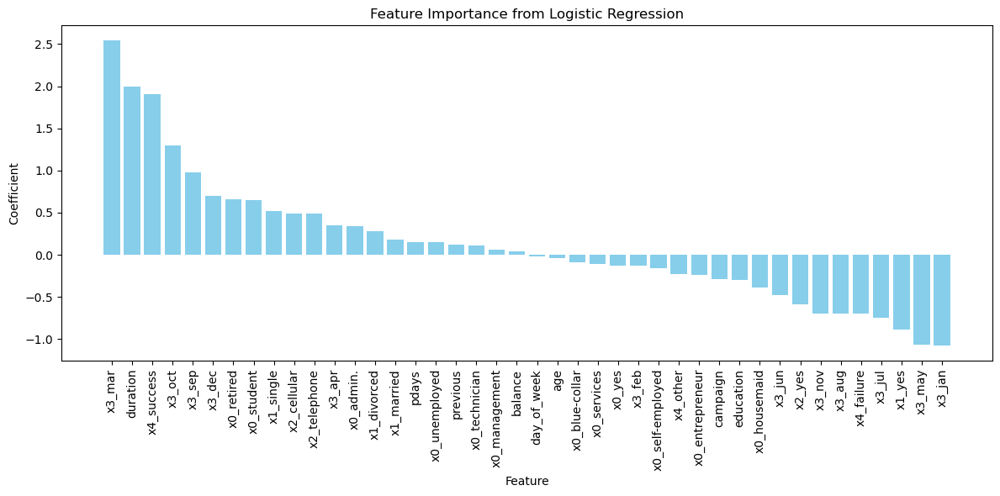

In [249]:
df = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': coefficients
})

# Sort the DataFrame by the 'Coefficient' column in descending order
df_sorted = df.sort_values('Coefficient', ascending=False)

# Plot the sorted coefficients using a bar chart
plt.figure(figsize=(12, 6))
plt.bar(df_sorted['Feature'], df_sorted['Coefficient'], color='skyblue')
plt.xlabel('Feature')
plt.ylabel('Coefficient')
plt.title('Feature Importance from Logistic Regression')
plt.xticks(rotation=90)  # Rotate feature names for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
plt.show()